<a href="https://colab.research.google.com/github/tyemalshara/tyemalshara/blob/main/Copy_of_Studienarbeit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Load the Drive helper and mount 
from google.colab import drive

# This will promt for authorization
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# After executing the cell above, Drive
# files will be present in "/content/drive/My Drive".
!ls "/content/dataset/subset-4/loco-all-v1.json"

ls: cannot access '/content/dataset/subset-4/loco-all-v1.json': No such file or directory


In [ ]:
# I have my dataset uploaded to my GoogleDrive. Herein I am unzipping it to use it.
# !unzip /content/drive/MyDrive/Data/subset-1_val.zip > /dev/null
!unzip /content/drive/MyDrive/Data/subset-1.zip > /dev/null



In [ ]:
# Download the JSON file with the annotations needed for the dataset.
!wget https://raw.githubusercontent.com/tum-fml/loco/main/rgb/loco-all-v1.json

--2022-06-12 22:19:02--  https://raw.githubusercontent.com/tum-fml/loco/main/rgb/loco-all-v1.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 103523578 (99M) [text/plain]
Saving to: ‘loco-all-v1.json’

loco-all-v1.json    100%[===================>]  98.73M   303MB/s    in 0.3s    

2022-06-12 22:19:02 (303 MB/s) - ‘loco-all-v1.json’ saved [103523578/103523578]



In [ ]:
# install dependencies: 
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 20 kB/s 
     |████████████████████████████████| 6.6 MB 48.3 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0+cu113
    Uninstalling torch-1.11.0+cu113:
      Successfully uninstalled torch-1.11.0+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.12.0+cu113
    Uninstalling torchvision-0.12.0+cu113:
      Successfully uninstalled torchvision-0.12.0+cu113
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.12.0 requires torch==1.11.0, but you have torch 1.5.0+cu101 which is incompatible.
torchaudio 0.11.0+cu113 requires torch==1.11.0, but you have torch 1.5.0+cu101

In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import itertools
import random
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.logger import setup_logger
from detectron2.engine import DefaultTrainer

import torch
setup_logger()

In [ ]:
# Run this Code to avoid double registering of the dataset in case of registering in the Catalogs twice for plausibility testing.   
DatasetCatalog.clear()

In [ ]:
import json
import os
import numpy as np
from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog, DatasetCatalog

def get_fahrzeug_dicts(img_dir):
    json_file = os.path.join(img_dir, "loco-all-v1.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)
    os.close
    
    anno = imgs_anns['annotations']
    anno_list_5 = [x for x in anno if x['category_id'] == 5]        # Bilder annotationen mit category id 5 -> forklift

    image_id_only_list = []     # hier sind alle 'image id' aus 'anno_list_5' aufgelistet. Aktuell nur für 'category_id' 5
    for y in range(len(anno_list_5)):
        image_id_list = []
        image_id_list = anno_list_5[y]['image_id']
        image_id_only_list.append(image_id_list)
    ########################################################
    ##### Delete duplicates from "image_id_only_list" ######
    ########################################################
    my_final_list = set(image_id_only_list)
    image_id_only_list = list(my_final_list)
    image_id_only_list.sort()

    imgs = imgs_anns['images']
    newlist = []        # images with objects containing the same 'id' from 'image_id_only_list'
    a = 0
    for z in imgs:
        for a in range(len(image_id_only_list)):
            if z['id'] == image_id_only_list[a]:
                newlist.append(z)

    # now I have to add the objects from 'anno_list_5' -> annotations, to the list 'newlist' -> images 
    b = 1
    c = 0
    hilf_list = [31848]
    image_id_old = 31848
    list_anno = []
    list_anno_outer = []

    for j in anno_list_5:
        dict_anno = {}
        image_id = j['image_id']
        hilf_list.append(image_id)
        image_id_old = hilf_list[b - 1]
        b = b + 1
        bbox = j['bbox']
        dict_anno['bbox'] = bbox
        dict_anno['bbox_mode'] = BoxMode.XYWH_ABS
        dict_anno['category_id'] = 0
        if image_id != image_id_old:
            list_anno_outer.append(list_anno)
            list_anno = []
            list_anno.append(dict_anno)
            continue
        list_anno.append(dict_anno)
        
    result = []
    for i in newlist:
        id = i['id']
        bild_name = i['file_name']
        path = "/content/Datensatz/subset-1/" + bild_name
        width = i['width']
        height = i['height']
        my_dict = {
            'file_name' : path,
            'image_id': id,
            'width': width,
            'height': height,
            'annotations': list_anno_outer[c]
        }
        c = c + 1
        if c >= len(list_anno_outer):
            break
        result.append(my_dict)

    return result

from detectron2.data import DatasetCatalog, MetadataCatalog

for d in ["subset-1", "subset-1_val"]:
  DatasetCatalog.register("flurfoederzeug_" + d, lambda d=d: get_fahrzeug_dicts("/content/Datensatz/" + d))
  MetadataCatalog.get("flurfoederzeug_" + d).set(thing_classes=["flurfoederzeug"])

In [ ]:
# Evaluation of ranomly picked Pictures
evaluation = r'/content'
balloon_metadata = MetadataCatalog.get("flurfoederzeug_subset-1")
result = get_fahrzeug_dicts("/content/Datensatz/subset-1")
for d in random.sample(result, 1):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=1.2)
  vis = visualizer.draw_dataset_dict(d)
  os.chdir(evaluation)
  cv2.imwrite("pre_train_image_test_2.jpg", vis.get_image()[:, :, ::-1])

In [ ]:
# Evaluation of certain Pictures 
evaluation = r'/content'
balloon_metadata = MetadataCatalog.get("flurfoederzeug_subset-1")
result = get_fahrzeug_dicts("/content/Datensatz/subset-1")
# for d in random.sample(result, 1):
img = cv2.imread('/content/Datensatz/subset-1/1579164513.5807645.jpg')
visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=1.2)
vis = visualizer.draw_dataset_dict(result[14])
os.chdir(evaluation)
cv2.imwrite("pre_train_image_test_2.jpg", vis.get_image()[:, :, ::-1])

True

In [ ]:
# Training the Model
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("flurfoederzeug_subset-1",)
cfg.DATASETS.TEST = ("flurfoederzeug_subset-1_val", ) # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2 #each GPU will see 2 image per batch
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000 # 300 iterations seems good enough, but you can certainly train longer
cfg.SOLVER.STEPS = [] # do not decay learning rate
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Hat nur ein Class (flurförderzeug)
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[06/12 22:27:12 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f6e8b1.pkl: 243MB [00:14, 17.4MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_pre

[06/12 22:27:34 d2.engine.train_loop]: Starting training from iteration 0
[06/12 22:27:48 d2.utils.events]:  eta: 0:11:40  iter: 19  total_loss: 0.847  loss_cls: 0.723  loss_box_reg: 0.043  loss_rpn_cls: 0.034  loss_rpn_loc: 0.011  time: 0.7041  data_time: 0.0215  lr: 0.000005  max_mem: 3784M
[06/12 22:28:02 d2.utils.events]:  eta: 0:11:29  iter: 39  total_loss: 0.753  loss_cls: 0.651  loss_box_reg: 0.038  loss_rpn_cls: 0.031  loss_rpn_loc: 0.010  time: 0.7054  data_time: 0.0048  lr: 0.000010  max_mem: 3784M
[06/12 22:28:17 d2.utils.events]:  eta: 0:11:18  iter: 59  total_loss: 0.649  loss_cls: 0.523  loss_box_reg: 0.064  loss_rpn_cls: 0.036  loss_rpn_loc: 0.007  time: 0.7120  data_time: 0.0049  lr: 0.000015  max_mem: 3785M
[06/12 22:28:31 d2.utils.events]:  eta: 0:11:07  iter: 79  total_loss: 0.462  loss_cls: 0.370  loss_box_reg: 0.044  loss_rpn_cls: 0.036  loss_rpn_loc: 0.011  time: 0.7134  data_time: 0.0050  lr: 0.000020  max_mem: 3785M
[06/12 22:28:46 d2.utils.events]:  eta: 0:10:5

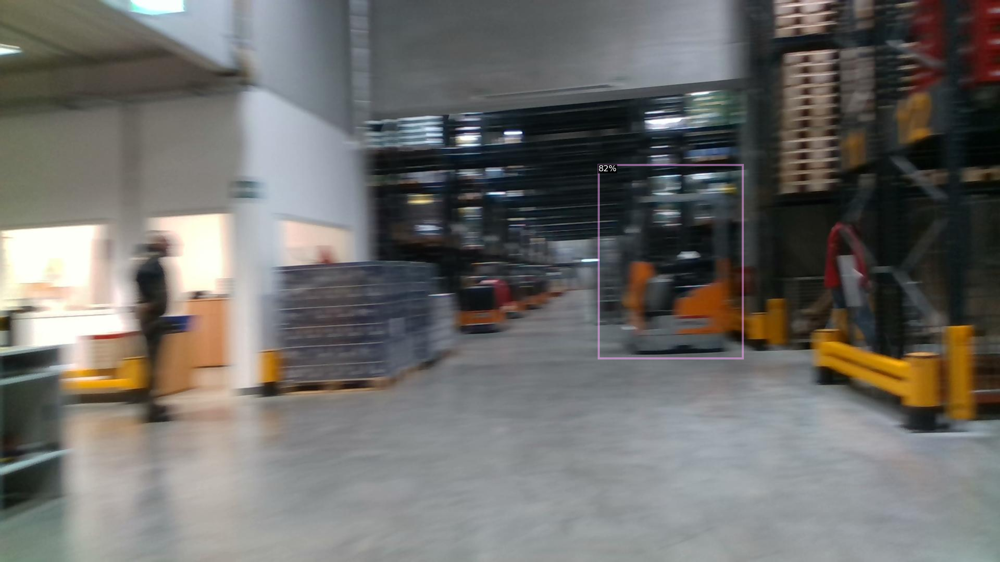

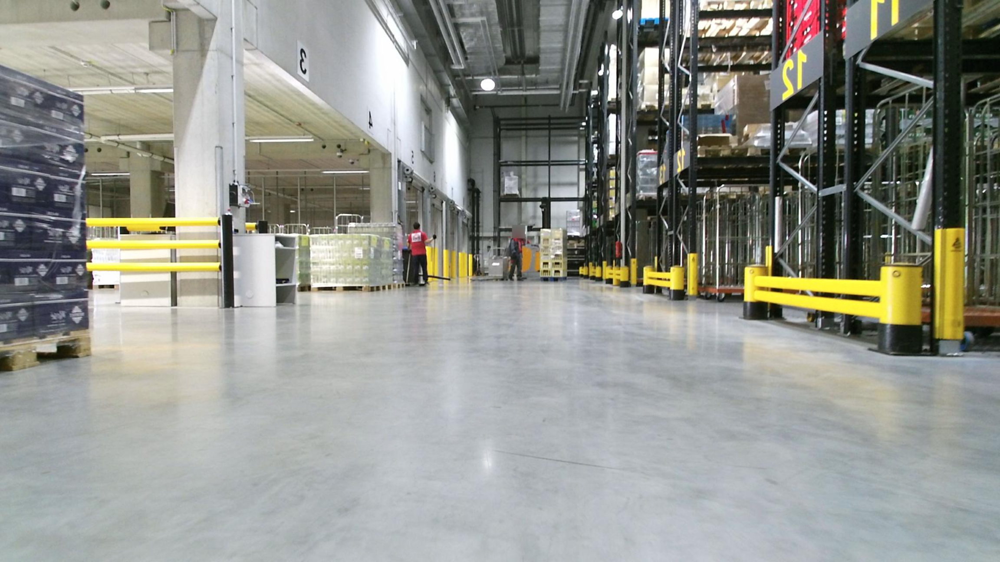

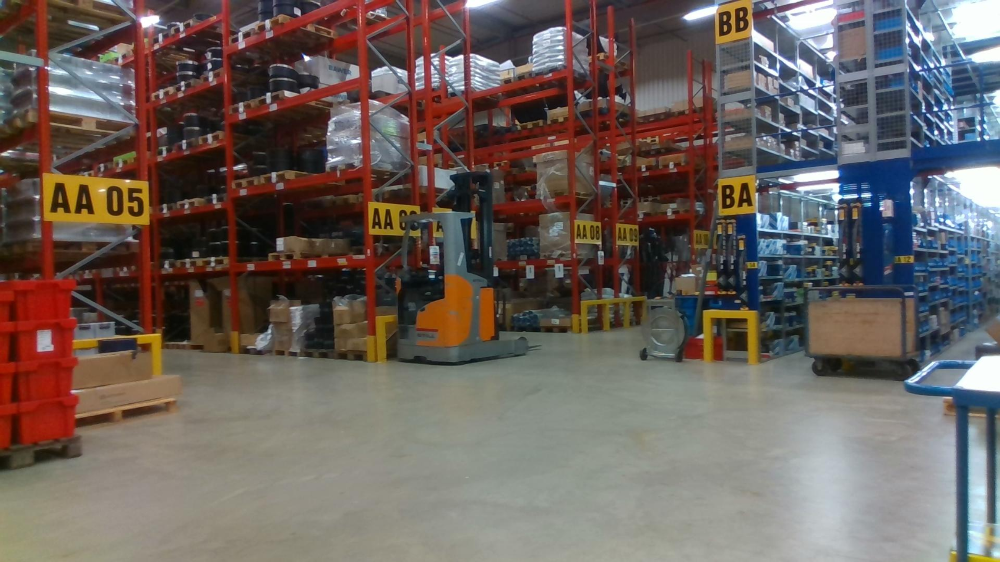

In [ ]:
# Evaluation of the trained Model with randomly picked Pictures 
# load weights
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.79 # set the testing threshold for this model
# Set training data-set path
cfg.DATASETS.TEST = ("flurfoederzeug_subset-1_val", )
# Create predictor (model for inference)
predictor = DefaultPredictor(cfg)
result = get_fahrzeug_dicts("/content/Datensatz/subset-1_val")
evaluation = r'/content'
for d in random.sample(result, 3):
  cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
  im = cv2.imread(d["file_name"]) # path des aktuell zu behandelndem Bild
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
  metadata=balloon_metadata,
  scale=1.2,
  instance_mode=ColorMode.IMAGE
  )
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  os.chdir(evaluation)
  cv2.imwrite("evaluate_output.jpg", v.get_image()[:, :, ::-1])
  cv2_imshow(v.get_image()[:, :, ::-1])


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("flurfoederzeug_subset-1", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "flurfoederzeug_subset-1")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

WARNING [06/12 23:46:55 d2.evaluation.coco_evaluation]: json_file was not found in MetaDataCatalog for 'flurfoederzeug_subset-1'. Trying to convert it to COCO format ...
[06/12 23:46:55 d2.data.datasets.coco]: Converting annotations of dataset 'flurfoederzeug_subset-1' to COCO format ...)
[06/12 23:46:57 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[06/12 23:46:57 d2.data.datasets.coco]: Conversion finished, #images: 447, #annotations: 596
[06/12 23:46:57 d2.data.datasets.coco]: Caching COCO format annotations at './output/flurfoederzeug_subset-1_coco_format.json' ...
[06/12 23:47:00 d2.data.common]: Serializing 447 elements to byte tensors and concatenating them all ...
[06/12 23:47:00 d2.data.common]: Serialized dataset takes 0.12 MiB
[06/12 23:47:00 d2.evaluation.evaluator]: Start inference on 447 images
[06/12 23:47:02 d2.evaluation.evaluator]: Inference done 11/447. 0.1546 s / img. ETA=0:01:08
[06/12 23:47:07 d2.evaluation.evaluator]: Inference done 44/447. 0.

In [ ]:
print(cfg.dump())

CUDNN_BENCHMARK: false
DATALOADER:
  ASPECT_RATIO_GROUPING: true
  FILTER_EMPTY_ANNOTATIONS: true
  NUM_WORKERS: 2
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: []
  PROPOSAL_FILES_TRAIN: []
  TEST:
  - flurfoederzeug_subset-1_val
  TRAIN:
  - flurfoederzeug_subset-1
GLOBAL:
  HACK: 1.0
INPUT:
  CROP:
    ENABLED: false
    SIZE:
    - 0.9
    - 0.9
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN:
  - 640
  - 672
  - 704
  - 736
  - 768
  - 800
  MIN_SIZE_TRAIN_SAMPLING: choice
MODEL:
  ANCHOR_GENERATOR:
    ANGLES:
    - - -90
      - 0
      - 90
    ASPECT_RATIOS:
    - - 0.5
      - 1.0
      - 2.0
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES:
    - - 32
    - - 64
    - - 128
    - - 256
    - - 512
  BACKBONE:
    FREEZE_AT: 2
    NAME: build_resnet_